## Computer Vision
 คือ สาขาหนึ่งของปัญญาประดิษฐ์ (AI) ที่เกี่ยวข้องกับการทำให้คอมพิวเตอร์สามารถ "เข้าใจ" และ "ตีความ" ข้อมูลจากภาพหรือวิดีโอ เช่น การตรวจจับวัตถุ การจำแนกประเภทภาพ การติดตามวัตถุ และการวิเคราะห์ฉาก โดยใช้เทคนิคต่าง ๆ เช่น การประมวลผลภาพ (Image Processing), การเรียนรู้ของเครื่อง (Machine Learning), และ Deep Learning

<img src="/mnt/d/workshop/Markdown/image1.png">

## Object Detection
การตรวจจับวัตถุ คือ เทคโนโลยีในทางคอมพิวเตอร์ หลักการที่เกี่ยวกับ Computer Vision และ Image Processing ที่ใช้ในงาน AI ตรวจจับวัตถุชนิดที่กำหนด เช่น มนุษย์ รถยนต์ อาคาร ที่อยู่ในรูปภาพ หรือวิดีโอ

<img src="/mnt/d/workshop/Markdown/image2.png">

## Install Yolo

In [ ]:
!pip install -q ultralytics

## Import Libraries

In [1]:
import requests
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from ultralytics import YOLO
from io import BytesIO
import numpy as np
import os
import random
import cv2
# import sys

## Load an Image

Image shape: (1271, 1860, 3)
[[[  8  11   2]
  [  9  12   3]
  [ 10  13   2]
  ...
  [ 27  29  26]
  [ 29  31  28]
  [ 36  38  35]]

 [[ 14  17   8]
  [ 14  17   6]
  [ 13  16   5]
  ...
  [ 34  36  33]
  [ 34  36  33]
  [ 37  39  36]]

 [[ 16  19   8]
  [ 16  20   6]
  [ 16  20   6]
  ...
  [ 35  37  32]
  [ 34  36  31]
  [ 33  35  30]]

 ...

 [[ 92 107 110]
  [ 96 111 114]
  [101 115 118]
  ...
  [ 91  95  96]
  [ 91  95  96]
  [ 89  93  94]]

 [[ 93 108 111]
  [ 94 109 112]
  [ 97 111 114]
  ...
  [ 89  93  94]
  [ 88  92  93]
  [ 83  87  88]]

 [[ 82  97 100]
  [ 87 102 105]
  [ 91 105 108]
  ...
  [101 105 106]
  [ 97 101 102]
  [ 88  92  93]]]


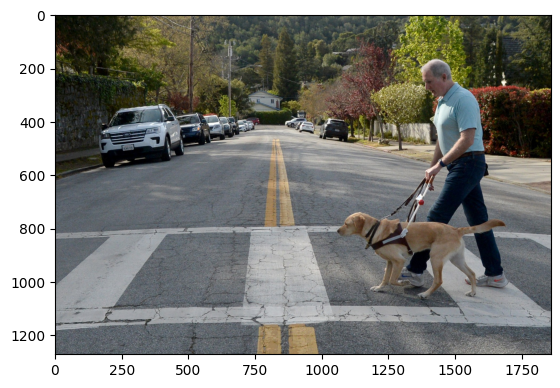

In [2]:
# np.set_printoptions(threshold=sys.maxsize)  # Set print options to show all elements in the array
image_url = "https://www.marinij.com/wp-content/uploads/2022/03/MIJ-L-GUIDEDOGS-03XX-20.jpg?w=1860"

response = requests.get(image_url)
image = Image.open(BytesIO(response.content))
image = image.convert('RGB')  # Make sure it's RGB
image_array = np.array(image)
plt.imshow(image)

print(f"Image shape: {image_array.shape}")
# print(image_array)

print(image_array)



## Image Components

Image shape: (1271, 1860, 3)
Image size: (1860, 1271)
Image array shape red: (1271, 1860)
Image array shape green: (1271, 1860)


<function print(*args, sep=' ', end='\n', file=None, flush=False)>

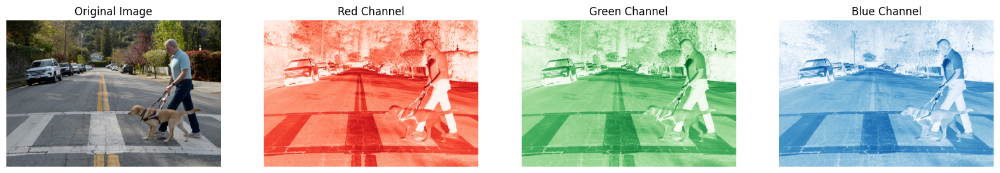

In [28]:
#show red, green, and blue channels
print("Image shape:", image_array.shape)
print("Image size:", image.size)

fig , ax = plt.subplots(1, 4, figsize=(20, 5))
ax[0].imshow(image)
ax[0].set_title('Original Image')
ax[0].axis('off')
ax[1].imshow(image_array[:, :, 0], cmap='Reds')
ax[1].set_title('Red Channel')
ax[1].axis('off')
print("Image array shape red:", image_array[:, :, 0].shape)
ax[2].imshow(image_array[:, :, 1], cmap='Greens')
ax[2].set_title('Green Channel')
ax[2].axis('off')
print("Image array shape green:", image_array[:, :, 1].shape)
ax[3].imshow(image_array[:, :, 2], cmap='Blues')
ax[3].set_title('Blue Channel')
ax[3].axis('off')
print

## Draw rectangle Area and Label

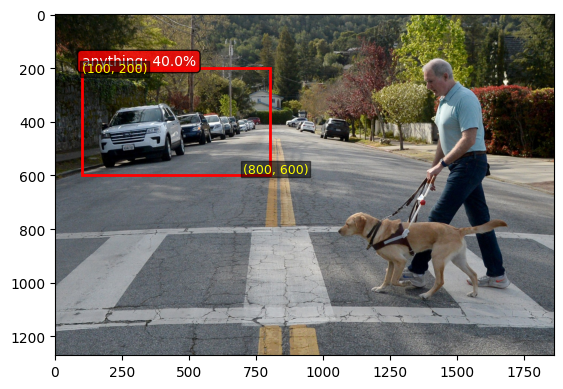

In [45]:
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.imshow(image_array)

x1, y1, x2, y2 = (100, 200, 800, 600)
confidence = 0.4
class_name = 'anything'

color = 'red'

width = x2 - x1
height = y2 - y1
rect = patches.Rectangle((x1, y1), width, height,
                         linewidth=2, edgecolor=color, facecolor='none')
ax.add_patch(rect)


label = f"{class_name}: {confidence:.1%}"
ax.text(x1, y1 - 10, label, fontsize=10, color='white',
        bbox=dict(boxstyle="round,pad=0.3", facecolor=color, alpha=0.8))



ax.text(x1, y1 + 15, f"({x1}, {y1})", fontsize=9, color='yellow',
        bbox=dict(facecolor='black', alpha=0.5, pad=1))


ax.text(x2 - 100, y2 - 10, f"({x2}, {y2})", fontsize=9, color='yellow',
        bbox=dict(facecolor='black', alpha=0.5, pad=1))


plt.tight_layout()
plt.show()

## Download YOLO Model
    สำหรับ YOLO Model นั้นมีหลาย Task ที่ สามารถทำงานได้
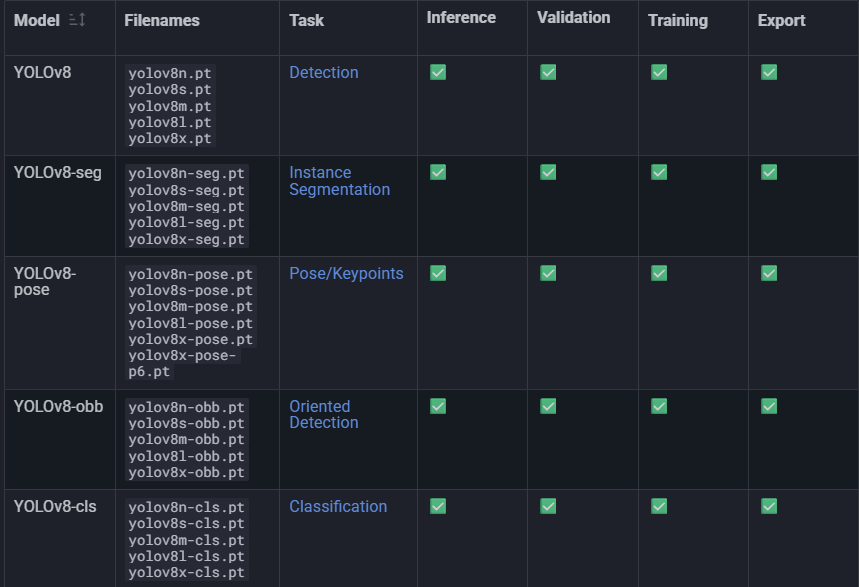

In [46]:
model = YOLO('yolov8n.pt')
print(model.names)

{0: 'person', 1: 'bicycle', 2: 'car', 3: 'motorcycle', 4: 'airplane', 5: 'bus', 6: 'train', 7: 'truck', 8: 'boat', 9: 'traffic light', 10: 'fire hydrant', 11: 'stop sign', 12: 'parking meter', 13: 'bench', 14: 'bird', 15: 'cat', 16: 'dog', 17: 'horse', 18: 'sheep', 19: 'cow', 20: 'elephant', 21: 'bear', 22: 'zebra', 23: 'giraffe', 24: 'backpack', 25: 'umbrella', 26: 'handbag', 27: 'tie', 28: 'suitcase', 29: 'frisbee', 30: 'skis', 31: 'snowboard', 32: 'sports ball', 33: 'kite', 34: 'baseball bat', 35: 'baseball glove', 36: 'skateboard', 37: 'surfboard', 38: 'tennis racket', 39: 'bottle', 40: 'wine glass', 41: 'cup', 42: 'fork', 43: 'knife', 44: 'spoon', 45: 'bowl', 46: 'banana', 47: 'apple', 48: 'sandwich', 49: 'orange', 50: 'broccoli', 51: 'carrot', 52: 'hot dog', 53: 'pizza', 54: 'donut', 55: 'cake', 56: 'chair', 57: 'couch', 58: 'potted plant', 59: 'bed', 60: 'dining table', 61: 'toilet', 62: 'tv', 63: 'laptop', 64: 'mouse', 65: 'remote', 66: 'keyboard', 67: 'cell phone', 68: 'microw

## YOLO Detection

0: 448x640 1 person, 4 cars, 1 truck, 1 dog, 19.5ms
Speed: 7.1ms preprocess, 19.5ms inference, 3.3ms postprocess per image at shape (1, 3, 448, 640)
Found 7 objects!
1. dog: 90.4%
   Position: (1055, 736) to (1682, 1070)
2. person: 81.6%
   Position: (1364, 162) to (1666, 1034)
3. car: 77.0%
   Position: (458, 368) to (583, 489)
4. car: 73.5%
   Position: (553, 372) to (636, 470)
5. truck: 72.6%
   Position: (165, 334) to (485, 572)
6. car: 70.4%
   Position: (996, 391) to (1098, 471)
7. car: 53.0%
   Position: (910, 401) to (973, 444)


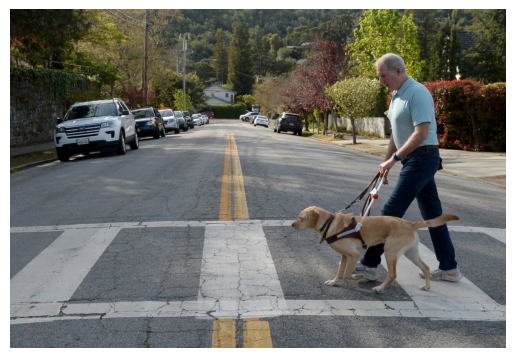

In [ ]:
results = model(image_array, conf=0.5)
detections = results[0].boxes

plt.imshow(image_array)
plt.axis('off')

boxes = detections.xyxy.cpu().numpy()  # x1, y1, x2, y2
confidences = detections.conf.cpu().numpy()  # confidence scores
class_ids = detections.cls.cpu().numpy()  # class IDs

print(f"Found {len(boxes)} objects!")

# Print each detection
for i in range(len(boxes)):
    x1, y1, x2, y2 = boxes[i]
    confidence = confidences[i]
    class_name = model.names[int(class_ids[i])]

    print(f"{i+1}. {class_name}: {confidence:.1%}")
    print(f"   Position: ({x1:.0f}, {y1:.0f}) to ({x2:.0f}, {y2:.0f})")

## Result Detection

/tmp/ipykernel_49034/3639904466.py:31: UserWarning: Glyph 127919 (\N{DIRECT HIT}) missing from font(s) DejaVu Sans.
  plt.tight_layout()


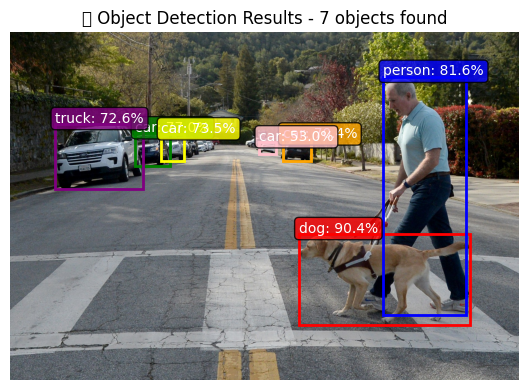

In [12]:
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.imshow(image_array)

# Draw each detection
if len(detections) > 0:
    # Colors for different object types
    colors = ['red', 'blue', 'green', 'yellow', 'purple', 'orange', 'pink', 'brown', 'gray', 'cyan']

    for i in range(len(boxes)):
        x1, y1, x2, y2 = boxes[i]
        confidence = confidences[i]
        class_name = model.names[int(class_ids[i])]

        # Choose color
        color = colors[i % len(colors)]

        # Draw rectangle
        width = x2 - x1
        height = y2 - y1
        rect = patches.Rectangle((x1, y1), width, height,
                               linewidth=2, edgecolor=color, facecolor='none')
        ax.add_patch(rect)

        # Add label
        label = f"{class_name}: {confidence:.1%}"
        ax.text(x1, y1-5, label, fontsize=10, color='white',
               bbox=dict(boxstyle="round,pad=0.3", facecolor=color, alpha=0.8))

ax.set_title(f'🎯 Object Detection Results - {len(detections) if len(detections) > 0 else 0} objects found')
ax.axis('off')
plt.tight_layout()
plt.show()

## Train Model

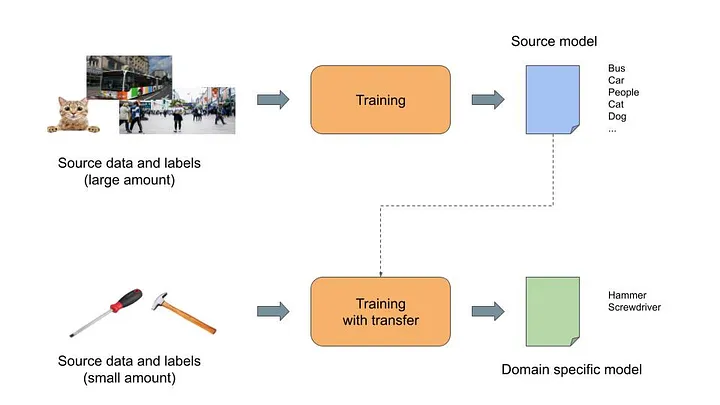

In [90]:
!unzip Anime-detecter.v2i.yolov8.zip

Archive:  Anime-detecter.v2i.yolov8.zip
  inflating: README.dataset.txt      
  inflating: README.roboflow.txt     
  inflating: data.yaml               
   creating: test/
   creating: test/images/
 extracting: test/images/10_jpg.rf.7da3e3930b6a00d847f6fd420eed2a9d.jpg  
 extracting: test/images/11_jpg.rf.803b0a0e4c1959a71896259078a59a93.jpg  
 extracting: test/images/12_jpg.rf.99cc2841534263e992988811230d70e0.jpg  
 extracting: test/images/13_jpg.rf.b27eed73e4284dae89d76d704fbe06ce.jpg  
 extracting: test/images/14_jpg.rf.af7b0b48c0d9a6d8ce057db24be69bf1.jpg  
 extracting: test/images/15_jpg.rf.fc6e1d812707586eb9d6bb13cc0ba033.jpg  
 extracting: test/images/16_jpg.rf.0ede5777bbdbd0006b36dc6e642e28a6.jpg  
 extracting: test/images/17_jpg.rf.84b692b70094fcbc358700429a6dce8d.jpg  
 extracting: test/images/18_jpg.rf.0324f7399fc310b103992dfdbd126206.jpg  
 extracting: test/images/19_jpg.rf.035e18ea5ce2ce9a261a932a4b09629f.jpg  
 extracting: test/images/1_jpg.rf.247acffd0f7aedc7ed0ecf689a7

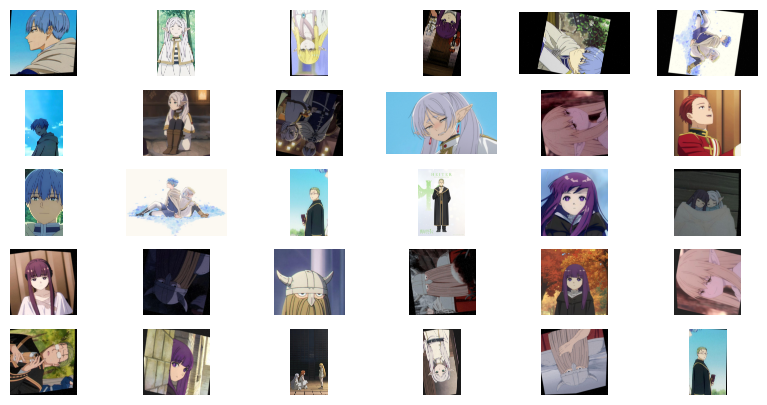

In [ ]:
directory_path_train = "train/images/"

file_name = [f for f in os.listdir(directory_path_train)] # Replace with your directory path
num_images = len(file_name)
file_simple = random.sample(file_name, 30)

fig, axs = plt.subplots(5, 6 ,figsize=(10 , 5))
for i, ax in enumerate(axs.flat):
    if i < len(file_simple):
        ax.imshow(Image.open(os.path.join(directory_path_train, file_simple[i])))
        ax.axis('off')
    else:
        ax.axis('off')  # Hide empty subplots

In [ ]:
#Training a YOLO model
model = YOLO('yolov8n.pt')

model.train(data="data.yaml", epochs=5, imgsz=640 , device='0')  # Use GPU if available, otherwise use CPU


image 1/1 /mnt/d/Yolo/frieren-beyond-journeys-end-768x432.webp: 384x640 3 persons, 34.8ms
Speed: 4.0ms preprocess, 34.8ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /mnt/d/Yolo/frieren-beyond-journeys-end-768x432.webp: 384x640 1 Eisen, 1 Frieren, 1 Himmel, 12.2ms
Speed: 1.6ms preprocess, 12.2ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


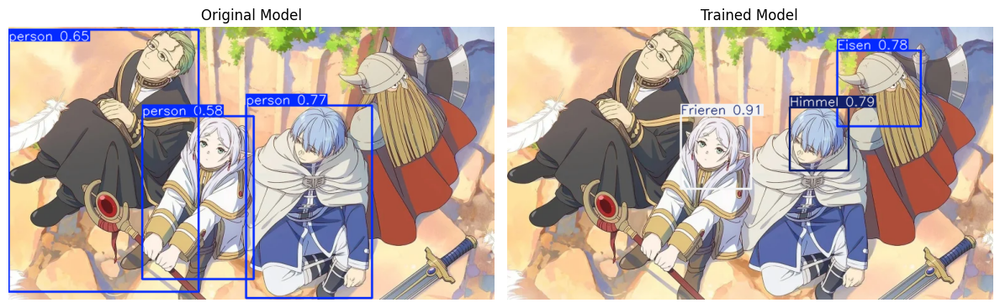

In [99]:
newmodel = YOLO("100_epoch.pt")  # Load the trained model
model = YOLO("yolov8n.pt")  # Load the original model

dictionary_path_test = "test/images/"
file_name_test = [f for f in os.listdir(dictionary_path_test)] # Replace with your directory path




Img = "/mnt/d/Yolo/frieren-beyond-journeys-end-768x432.webp"

resultmodel = model(Img)
resultnewmodel = newmodel(Img)
img1 = resultmodel[0].plot()        # Original model
img2 = resultnewmodel[0].plot()     # Trained model

# Convert BGR to RGB for matplotlib
img1_rgb = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2_rgb = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

# Plot side-by-side
fig, axs = plt.subplots(1, 2, figsize=(12, 6))
axs[0].imshow(img1_rgb)
axs[0].set_title("Original Model")
axs[0].axis('off')

axs[1].imshow(img2_rgb)
axs[1].set_title("Trained Model")
axs[1].axis('off')

plt.tight_layout()
plt.show()


image 1/1 /mnt/d/workshop/test/images/10_jpg.rf.7da3e3930b6a00d847f6fd420eed2a9d.jpg: 640x640 1 Frieren, 78.0ms
Speed: 87.3ms preprocess, 78.0ms inference, 20.8ms postprocess per image at shape (1, 3, 640, 640)


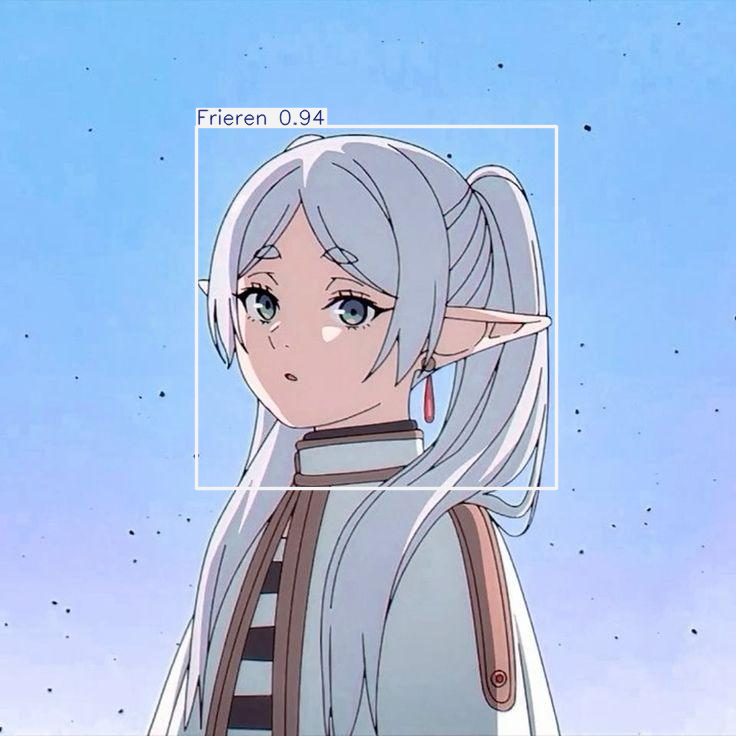


image 1/1 /mnt/d/workshop/test/images/11_jpg.rf.803b0a0e4c1959a71896259078a59a93.jpg: 640x640 1 Heiter, 19.6ms
Speed: 14.6ms preprocess, 19.6ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)


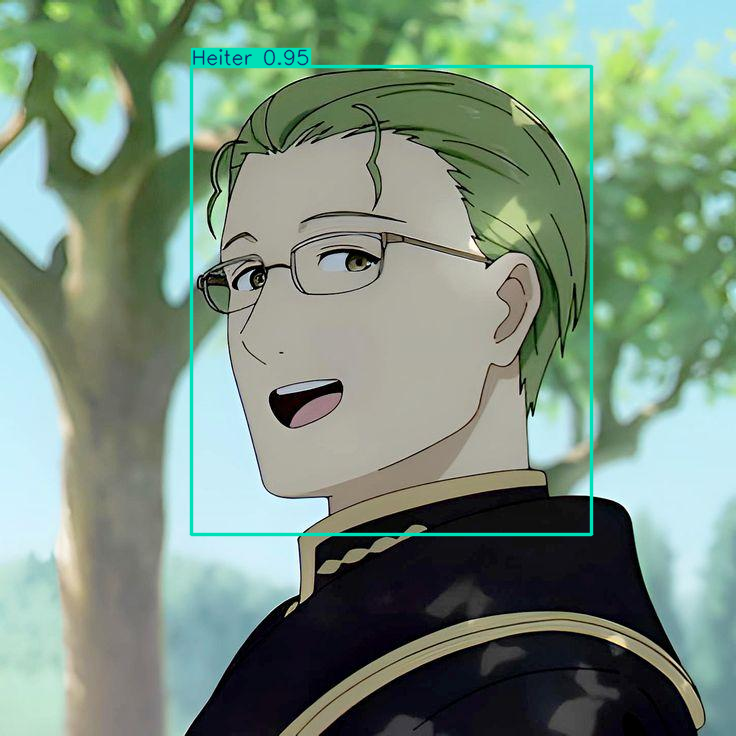


image 1/1 /mnt/d/workshop/test/images/12_jpg.rf.99cc2841534263e992988811230d70e0.jpg: 384x640 1 Eisen, 91.7ms
Speed: 10.6ms preprocess, 91.7ms inference, 3.9ms postprocess per image at shape (1, 3, 384, 640)


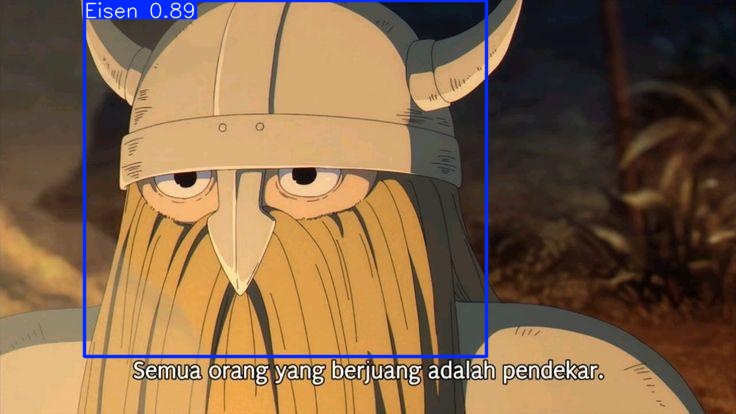


image 1/1 /mnt/d/workshop/test/images/13_jpg.rf.b27eed73e4284dae89d76d704fbe06ce.jpg: 640x640 1 Eisen, 14.2ms
Speed: 4.9ms preprocess, 14.2ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)


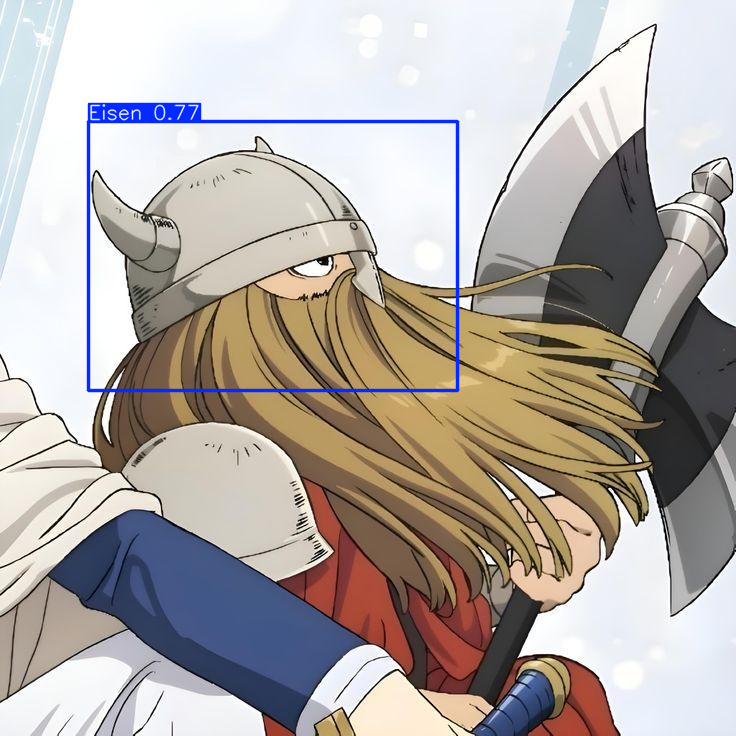


image 1/1 /mnt/d/workshop/test/images/14_jpg.rf.af7b0b48c0d9a6d8ce057db24be69bf1.jpg: 608x640 2 Eisens, 127.3ms
Speed: 4.0ms preprocess, 127.3ms inference, 4.0ms postprocess per image at shape (1, 3, 608, 640)


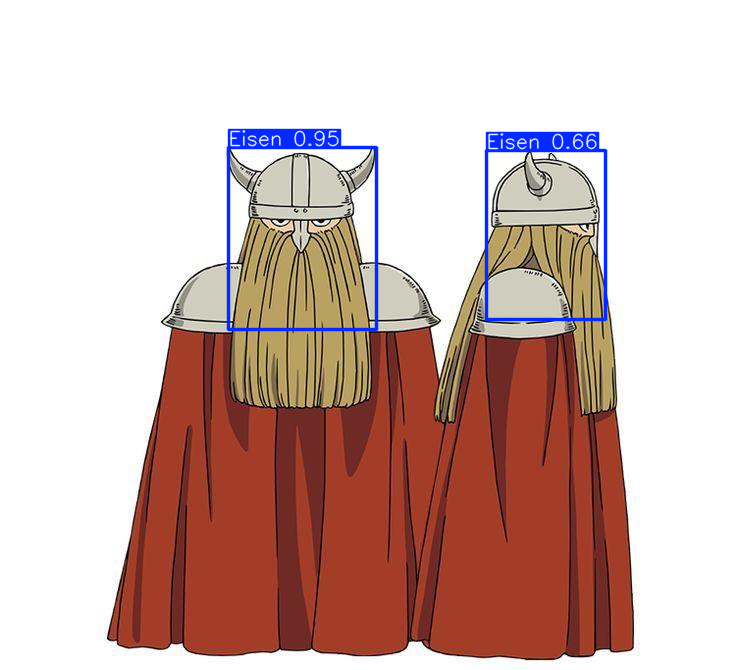


image 1/1 /mnt/d/workshop/test/images/15_jpg.rf.fc6e1d812707586eb9d6bb13cc0ba033.jpg: 640x384 1 Eisen, 1 Fern, 1 Frieren, 1 Heiter, 1 Himmel, 1 Stark, 27.6ms
Speed: 1.8ms preprocess, 27.6ms inference, 7.4ms postprocess per image at shape (1, 3, 640, 384)


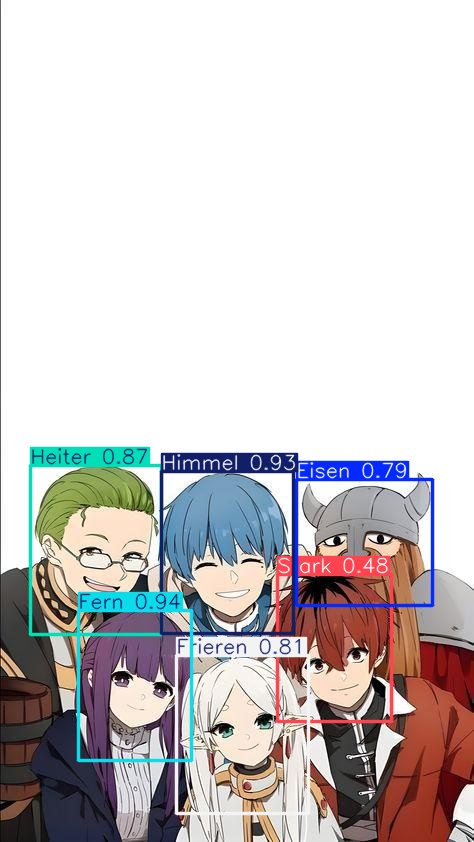


image 1/1 /mnt/d/workshop/test/images/16_jpg.rf.0ede5777bbdbd0006b36dc6e642e28a6.jpg: 640x576 1 Frieren, 1 Himmel, 92.3ms
Speed: 4.6ms preprocess, 92.3ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 576)


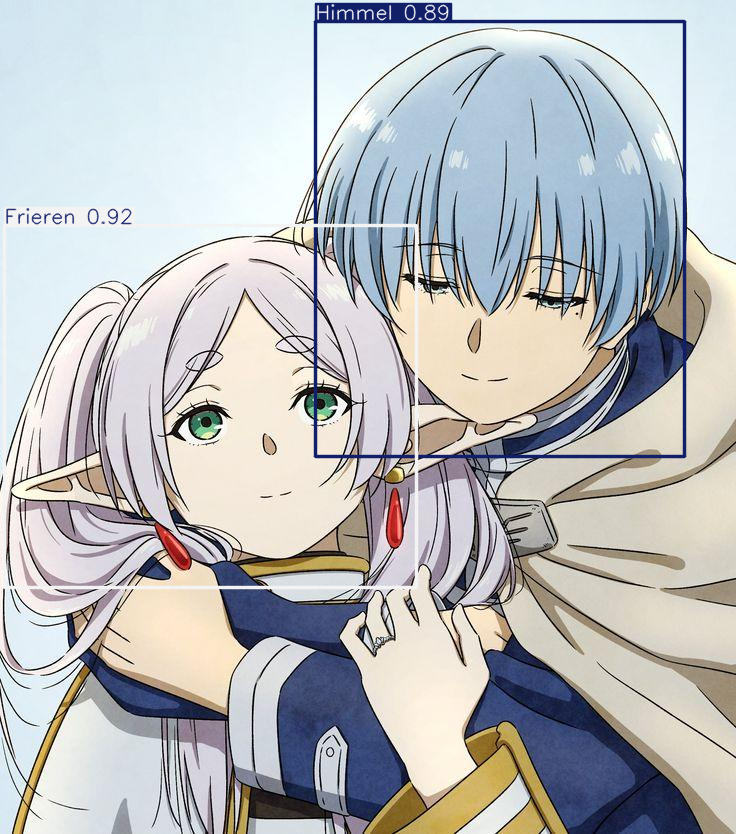


image 1/1 /mnt/d/workshop/test/images/17_jpg.rf.84b692b70094fcbc358700429a6dce8d.jpg: 640x480 1 Frieren, 1 Himmel, 30.2ms
Speed: 3.6ms preprocess, 30.2ms inference, 3.8ms postprocess per image at shape (1, 3, 640, 480)


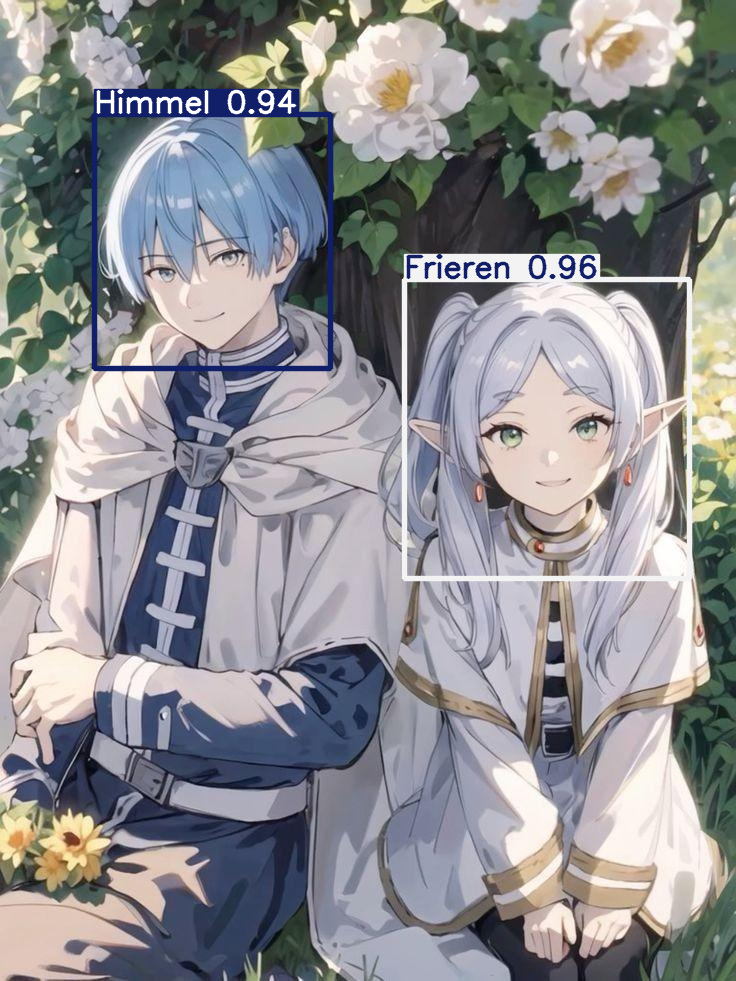


image 1/1 /mnt/d/workshop/test/images/18_jpg.rf.0324f7399fc310b103992dfdbd126206.jpg: 640x448 1 Fern, 99.1ms
Speed: 2.3ms preprocess, 99.1ms inference, 9.6ms postprocess per image at shape (1, 3, 640, 448)


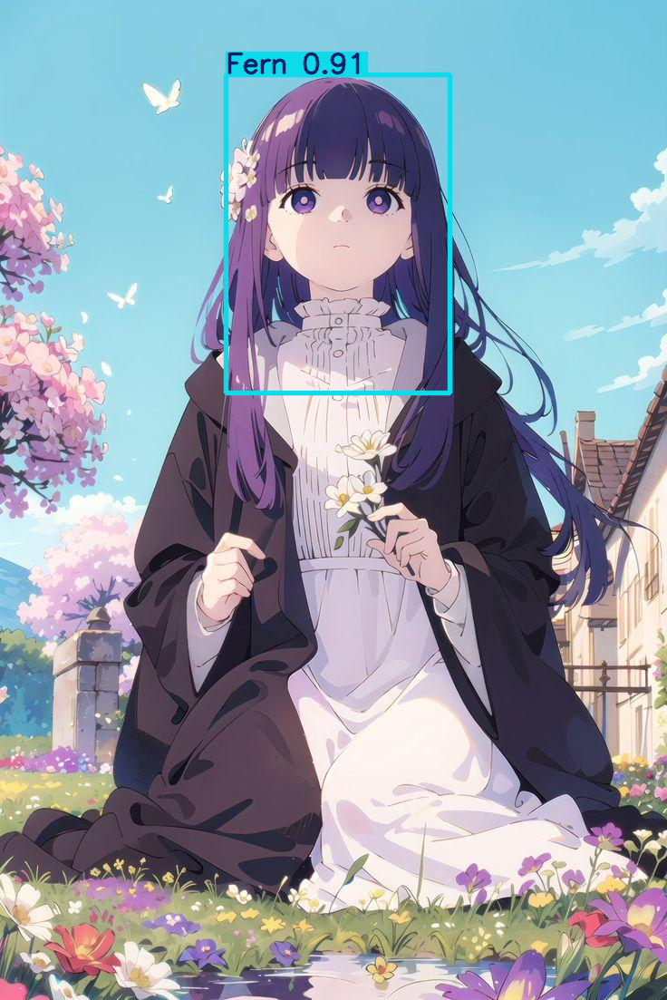


image 1/1 /mnt/d/workshop/test/images/19_jpg.rf.035e18ea5ce2ce9a261a932a4b09629f.jpg: 640x384 1 Fern, 1 Frieren, 12.5ms
Speed: 2.5ms preprocess, 12.5ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 384)


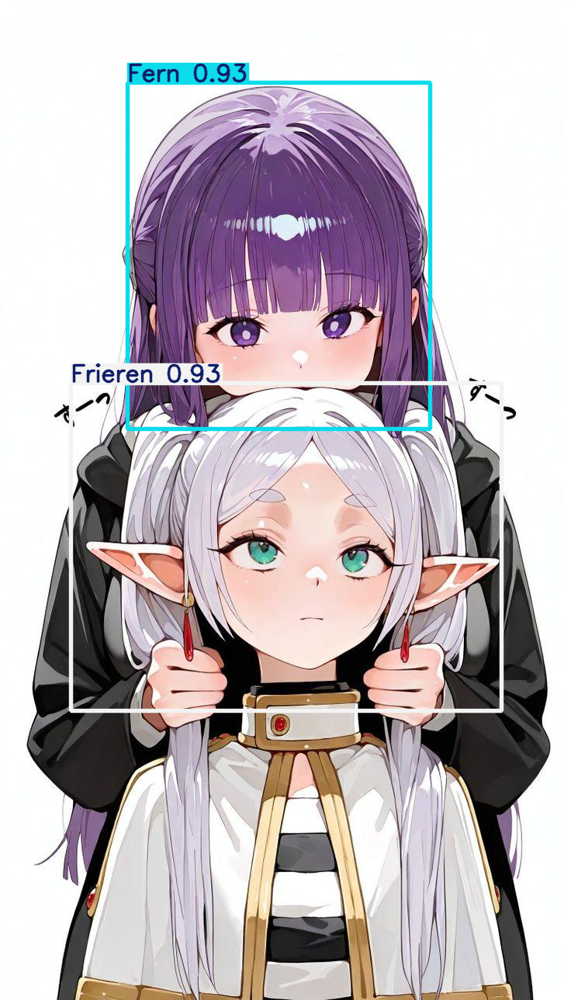


image 1/1 /mnt/d/workshop/test/images/1_jpg.rf.247acffd0f7aedc7ed0ecf689a7a4a12.jpg: 640x384 1 Frieren, 15.6ms
Speed: 3.2ms preprocess, 15.6ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 384)


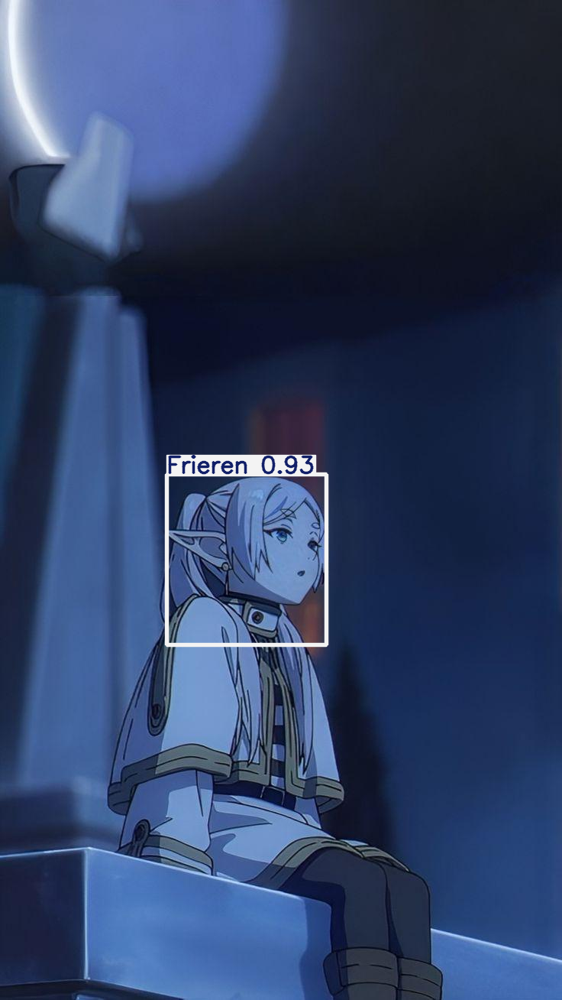


image 1/1 /mnt/d/workshop/test/images/20_jpg.rf.299b97e2d29ae095a24edba501e77231.jpg: 640x640 1 Serie, 28.1ms
Speed: 4.9ms preprocess, 28.1ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


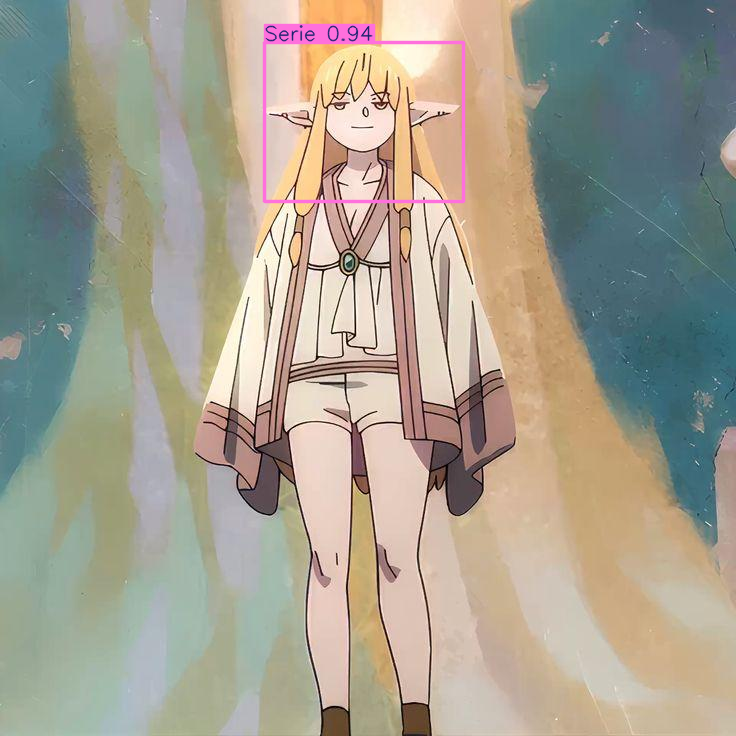


image 1/1 /mnt/d/workshop/test/images/21_jpg.rf.8e1a0c13a0d113e7c12a38abacefd00c.jpg: 640x640 1 Heiter, 27.1ms
Speed: 4.3ms preprocess, 27.1ms inference, 4.7ms postprocess per image at shape (1, 3, 640, 640)


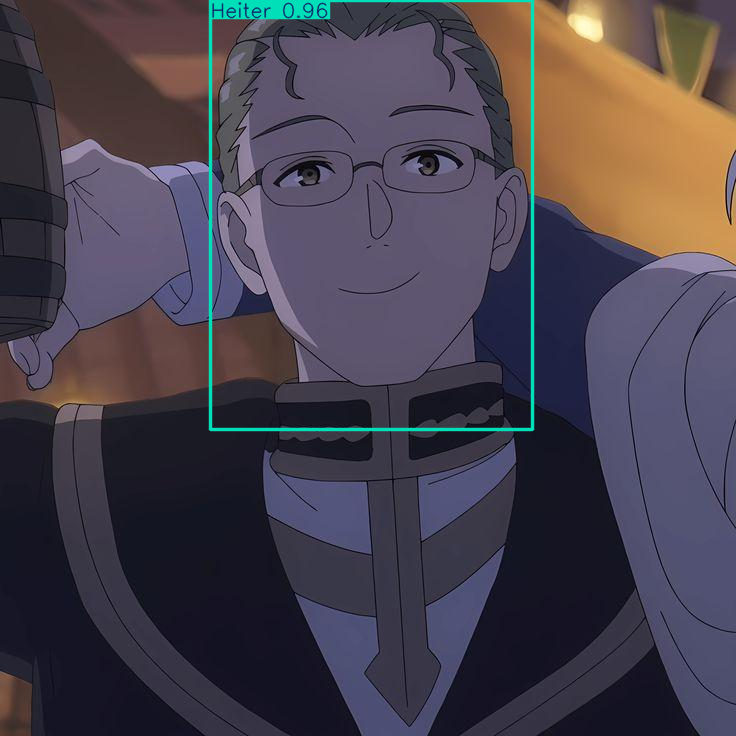


image 1/1 /mnt/d/workshop/test/images/22_jpg.rf.2072b929a11f97c5d2966f185d0a3618.jpg: 512x640 1 Fern, 1 Frieren, 119.6ms
Speed: 2.8ms preprocess, 119.6ms inference, 4.0ms postprocess per image at shape (1, 3, 512, 640)


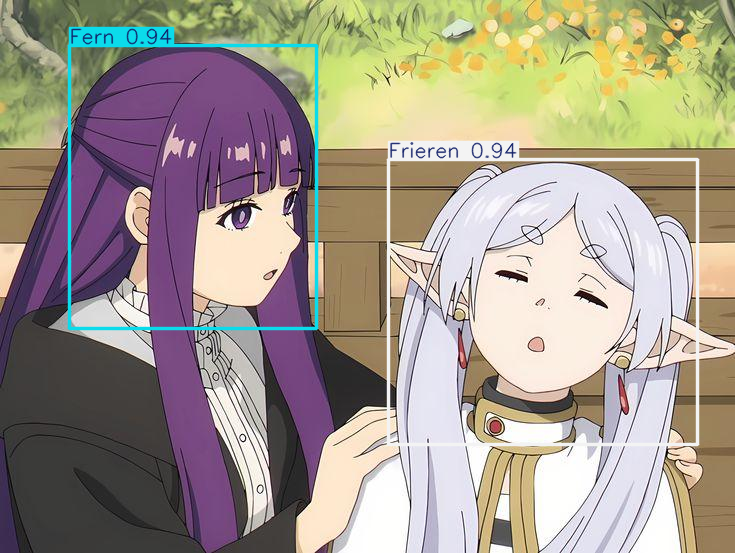


image 1/1 /mnt/d/workshop/test/images/23_jpg.rf.2a75231cb8e9752daa83fc9caadf9f5f.jpg: 640x640 1 Himmel, 13.2ms
Speed: 3.4ms preprocess, 13.2ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)


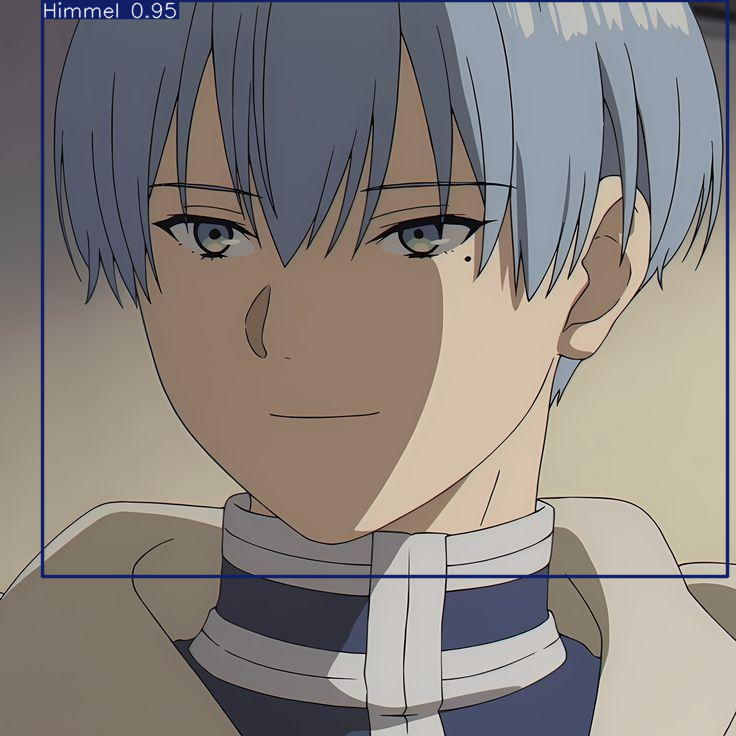


image 1/1 /mnt/d/workshop/test/images/24_jpg.rf.be420e0dde0d2c2f5ab9d74b3c9ccdf3.jpg: 640x640 1 Fern, 14.7ms
Speed: 3.4ms preprocess, 14.7ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


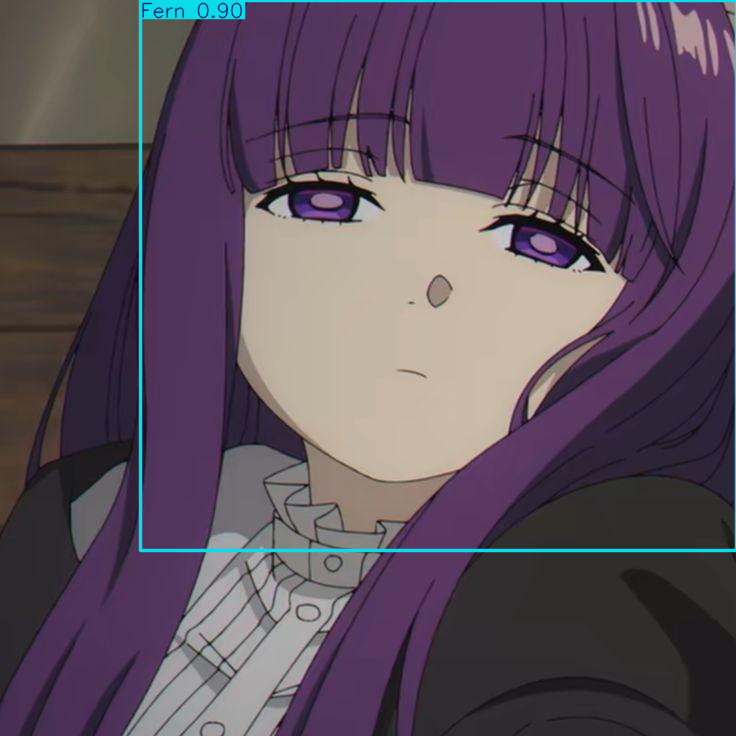


image 1/1 /mnt/d/workshop/test/images/25_jpg.rf.387f61cadcc034813dcb89ec9a02a796.jpg: 384x640 1 Fern, 14.9ms
Speed: 3.1ms preprocess, 14.9ms inference, 3.3ms postprocess per image at shape (1, 3, 384, 640)


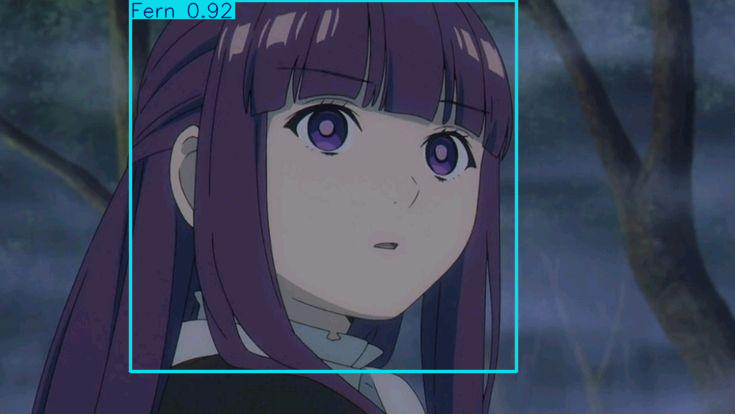


image 1/1 /mnt/d/workshop/test/images/2_jpg.rf.e78c0735d559892ca1c8937d07add8fd.jpg: 640x384 1 Frieren, 29.4ms
Speed: 3.3ms preprocess, 29.4ms inference, 3.4ms postprocess per image at shape (1, 3, 640, 384)


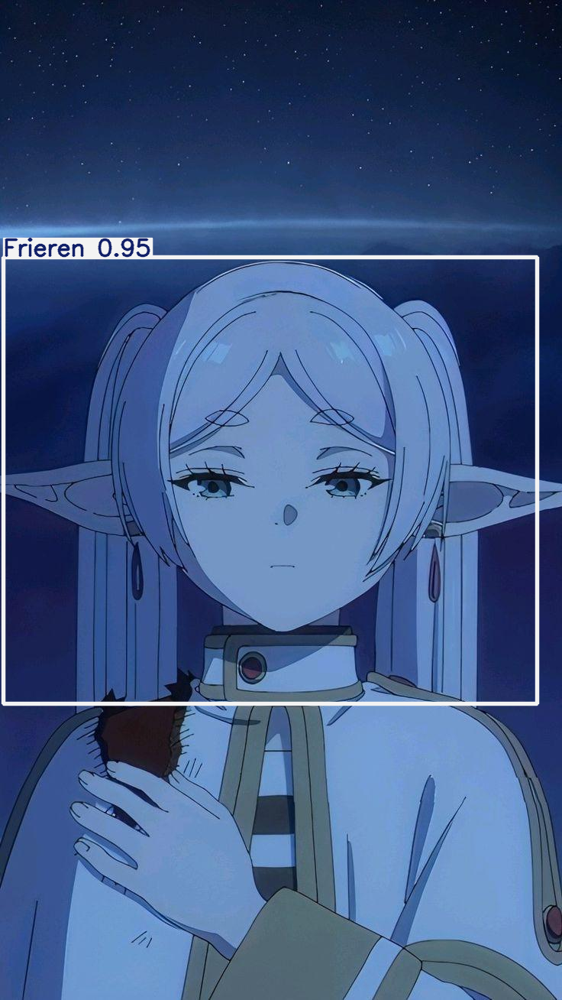


image 1/1 /mnt/d/workshop/test/images/3_jpg.rf.4de4bb7aad017dafce6ae9f5df031c7b.jpg: 640x384 1 Frieren, 21.8ms
Speed: 3.4ms preprocess, 21.8ms inference, 7.8ms postprocess per image at shape (1, 3, 640, 384)


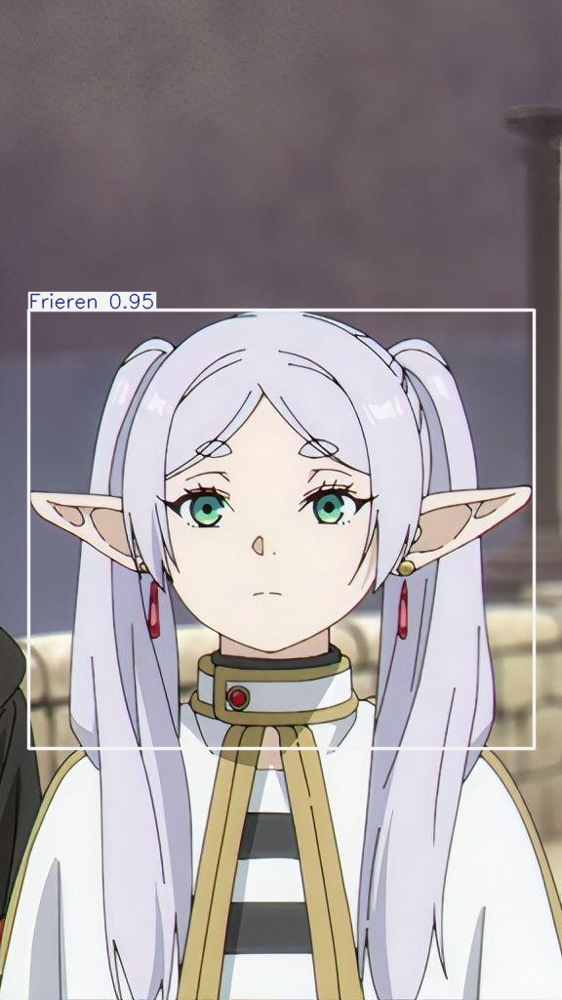


image 1/1 /mnt/d/workshop/test/images/4_jpg.rf.e85be990ef7940b0af5528b9561472f4.jpg: 640x640 1 Frieren, 24.4ms
Speed: 5.2ms preprocess, 24.4ms inference, 4.6ms postprocess per image at shape (1, 3, 640, 640)


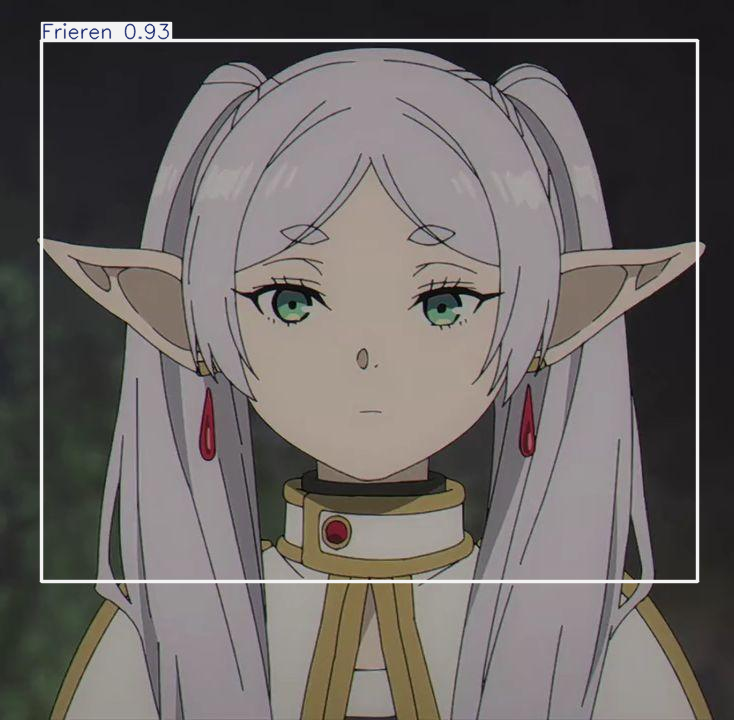


image 1/1 /mnt/d/workshop/test/images/5_jpg.rf.740f06f60431bacf9bc683eee044c39c.jpg: 640x640 1 Frieren, 20.1ms
Speed: 3.8ms preprocess, 20.1ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


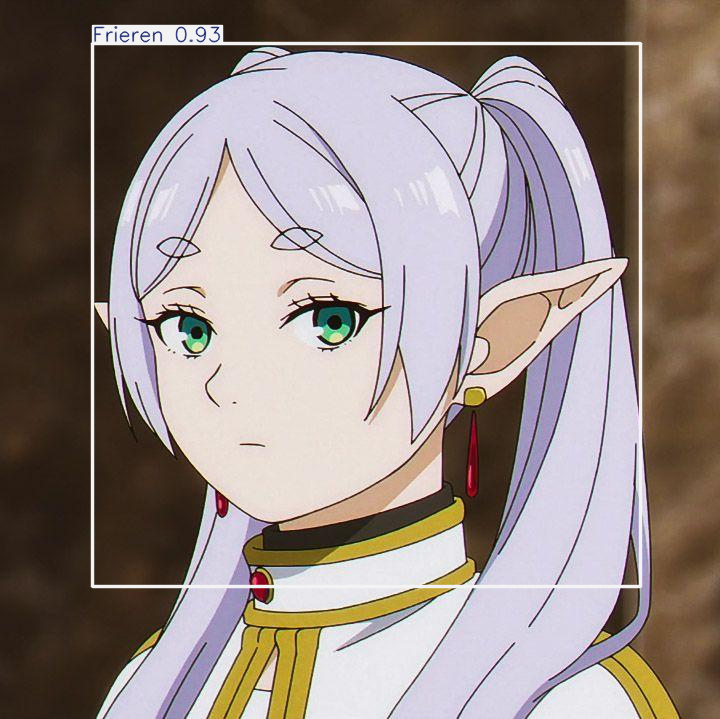


image 1/1 /mnt/d/workshop/test/images/6_jpg.rf.7f50d01e17484446d9a1d929117784c2.jpg: 640x640 1 Frieren, 25.5ms
Speed: 11.5ms preprocess, 25.5ms inference, 5.8ms postprocess per image at shape (1, 3, 640, 640)


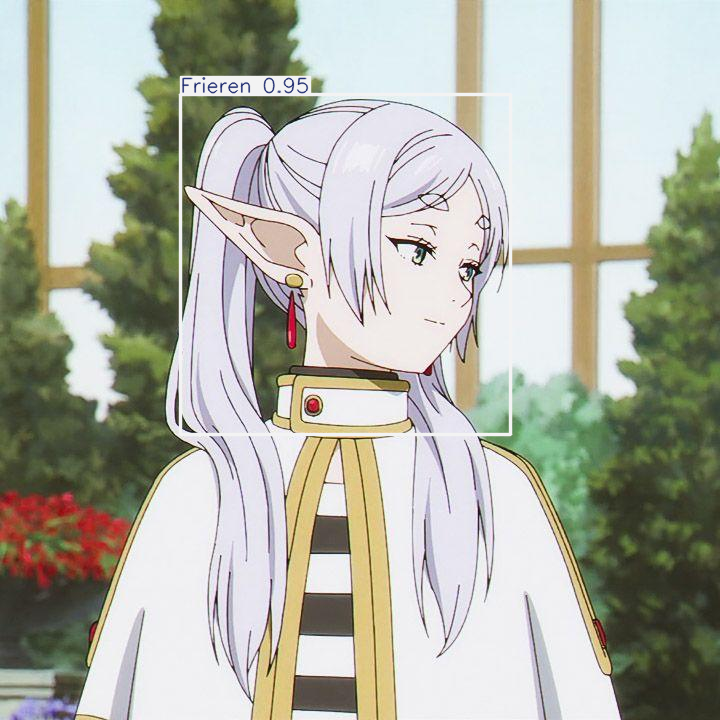


image 1/1 /mnt/d/workshop/test/images/7_jpg.rf.f2851097b0ba38f65aa245bdf4aed646.jpg: 640x640 1 Eisen, 1 Himmel, 42.0ms
Speed: 7.0ms preprocess, 42.0ms inference, 11.5ms postprocess per image at shape (1, 3, 640, 640)


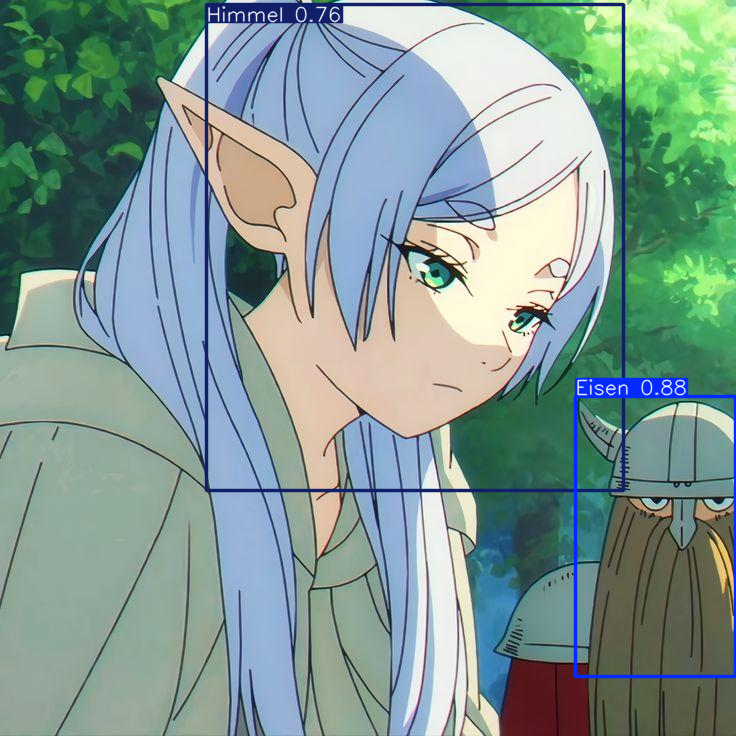


image 1/1 /mnt/d/workshop/test/images/8_jpg.rf.5fa3c950407a298623f1f1e6825e29e8.jpg: 640x640 1 Frieren, 36.6ms
Speed: 7.5ms preprocess, 36.6ms inference, 7.6ms postprocess per image at shape (1, 3, 640, 640)


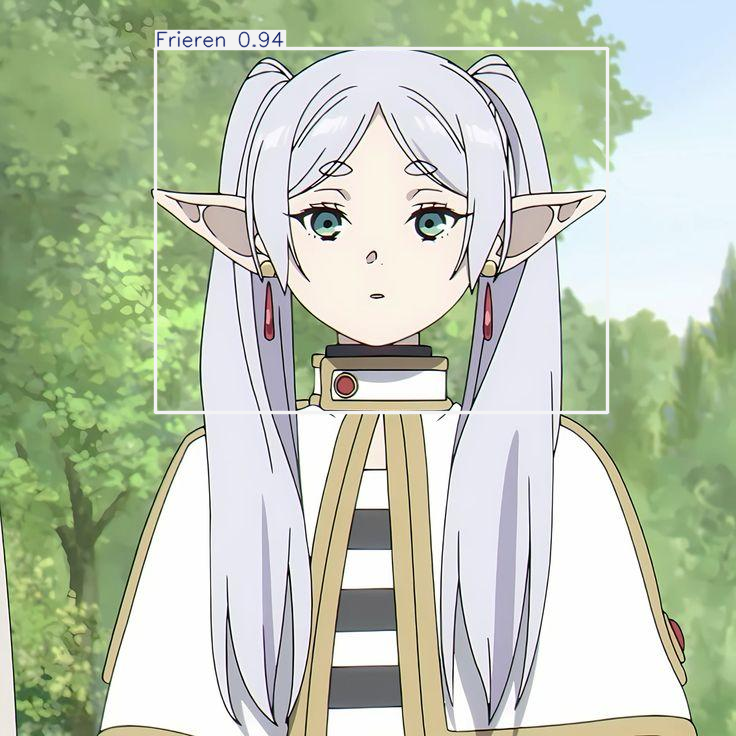


image 1/1 /mnt/d/workshop/test/images/9_jpg.rf.e46a3615afcda3a8f7f3daa4bc30f464.jpg: 640x384 1 Frieren, 33.8ms
Speed: 8.7ms preprocess, 33.8ms inference, 3.0ms postprocess per image at shape (1, 3, 640, 384)


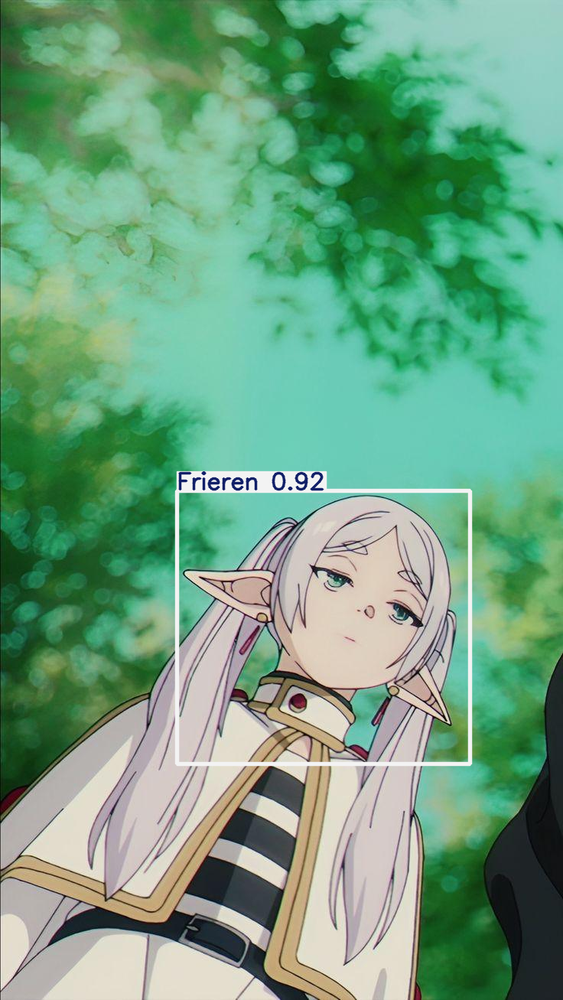

In [109]:
for i in range(len(file_name_test)):
    Img = os.path.join(dictionary_path_test, file_name_test[i])
    result = newmodel(Img)
    result[0].show()  # Show the detection results for each image